In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
from tqdm.auto import tqdm
import pandas as pd

# PCA

In [ ]:
from sklearn.decomposition import PCA
from matplotlib.patches import Rectangle

In [ ]:
def visualize_2d(pca_results, title="", percentile_range=(40, 60), figsize=(10, 5)):
    """
    Visualize PCA results in 2D with central region highlighting

    Args:
        pca_results: numpy array of shape (n_samples, 2) - precomputed 2D PCA
        title: plot title
        percentile_range: tuple defining central region (lower, upper)
        figsize: figure dimensions
    """
    xl, xr = np.percentile(pca_results[:,0], percentile_range)
    yl, yr = np.percentile(pca_results[:,1], percentile_range)
    idx = ((pca_results[:,0] < xr) & (pca_results[:,0] > xl) &
           (pca_results[:,1] < yr) & (pca_results[:,1] > yl))

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)

    # Full 2D plot
    ax1.scatter(pca_results[:, 0], pca_results[:, 1], s=1)
    rect = Rectangle((xl, yl), xr-xl, yr-yl, color='r', fill=False)
    ax1.add_patch(rect)
    ax1.set_title(f'{title} (all points)')

    # Central region plot
    ax2.scatter(pca_results[idx, 0], pca_results[idx, 1], s=1)
    ax2.set_title(f'{title} (central {percentile_range[0]}-{percentile_range[1]}%)')

    plt.tight_layout()
    plt.show()

In [ ]:
def visualize_3d(pca_results, title="", percentile_range=(40, 60), figsize=(18, 6)):
    """
    Visualize PCA results in 3D with central region highlighting

    Args:
        pca_results: numpy array of shape (n_samples, 3) - precomputed 3D PCA
        title: plot title
        percentile_range: tuple defining central region (lower, upper)
        figsize: figure dimensions
    """
    # Calculate central region based on first two dimensions
    xl, xr = np.percentile(pca_results[:,0], percentile_range)
    yl, yr = np.percentile(pca_results[:,1], percentile_range)
    idx = ((pca_results[:,0] < xr) & (pca_results[:,0] > xl) &
           (pca_results[:,1] < yr) & (pca_results[:,1] > yl))

    fig = plt.figure(figsize=figsize)

    # 3D Plot - All Points
    ax1 = fig.add_subplot(131, projection='3d')
    ax1.scatter(pca_results[:, 0], pca_results[:, 1], pca_results[:, 2], s=1)
    ax1.set_title(f'{title} (all points)')

    # 3D Plot - Central Points
    ax2 = fig.add_subplot(132, projection='3d')
    ax2.scatter(pca_results[idx, 0], pca_results[idx, 1], pca_results[idx, 2], s=1)
    ax2.set_title(f'{title} (central points)')

    # 2D Projection
    ax3 = fig.add_subplot(133)
    ax3.scatter(pca_results[:, 0], pca_results[:, 1], s=1)
    rect = Rectangle((xl, yl), xr-xl, yr-yl, color='r', fill=False)
    ax3.add_patch(rect)
    ax3.set_title('PC1 vs PC2 projection')

    plt.tight_layout()
    plt.show()

In [ ]:
# PCA transformations
pca_2d = PCA(n_components=2)
pca_3d = PCA(n_components=3)

## Words

In [ ]:
# Load only vectors
ru_word_space = np.load('ru_cbow_norm_embeddings.npy')
slv_word_space = np.load('slv_cbow_norm_embeddings.npy')

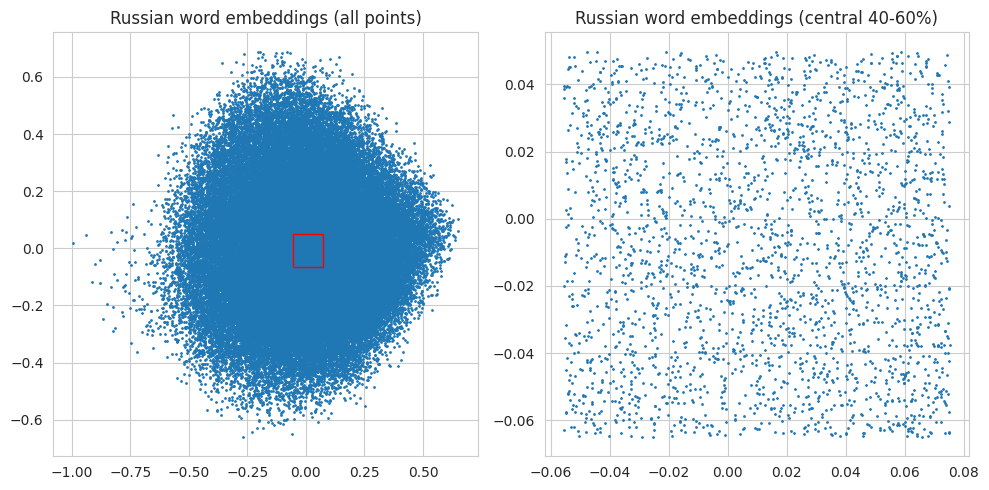

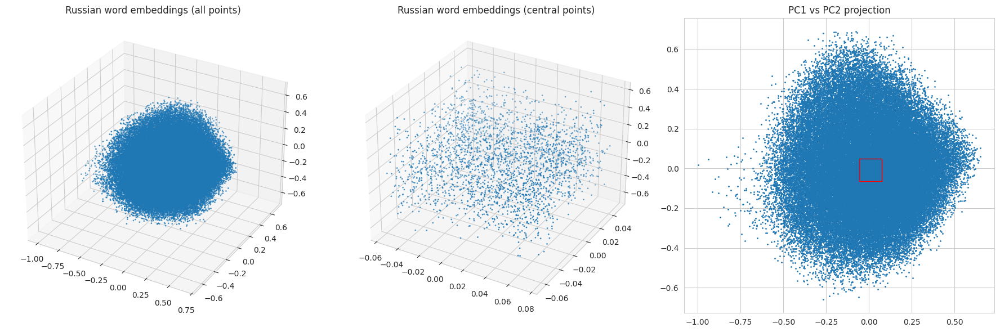

In [ ]:
ru_word_2d = pca_2d.fit_transform(ru_word_space)
ru_word_3d = pca_3d.fit_transform(ru_word_space)

# Visualize
visualize_2d(ru_word_2d, "Russian word embeddings")
visualize_3d(ru_word_3d, "Russian word embeddings")

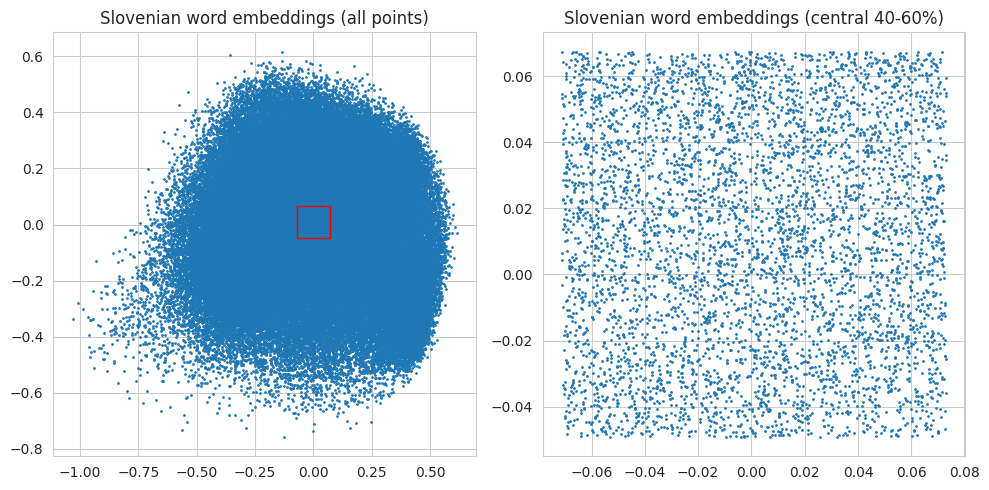

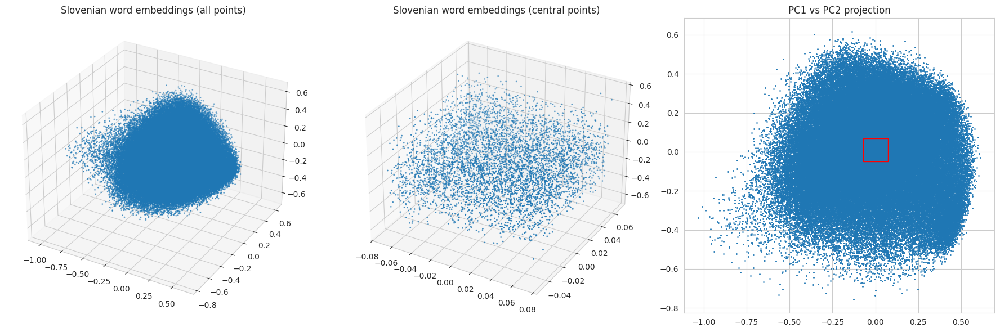

In [ ]:
slv_word_2d = pca_2d.fit_transform(slv_word_space)
slv_word_3d = pca_3d.fit_transform(slv_word_space)

visualize_2d(slv_word_2d, "Slovenian word embeddings")
visualize_3d(slv_word_3d, "Slovenian word embeddings")

## Bigrams

In [ ]:
# Load only vectors
ru_bigram_space = np.load('ru_bigram_norm_embeddings.npy')
slv_bigram_space = np.load('slv_bigram_norm_embeddings.npy')

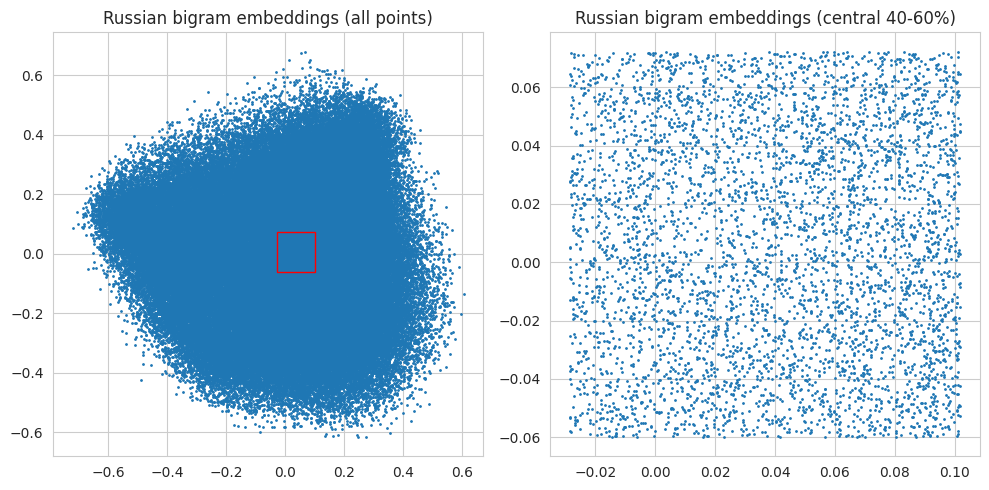

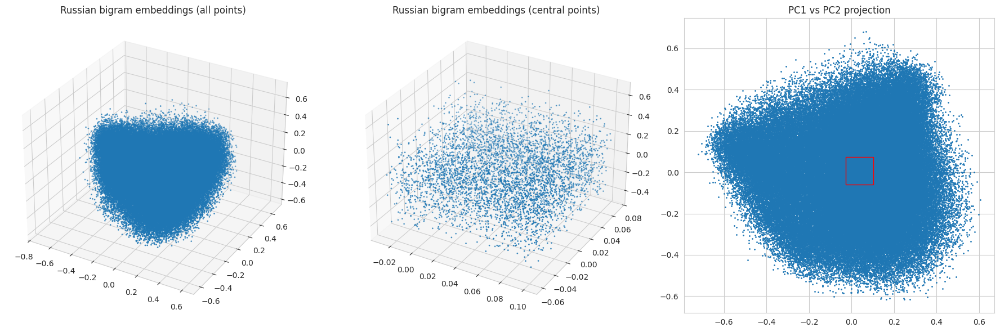

In [ ]:
ru_bigram_2d = pca_2d.fit_transform(ru_bigram_space)
ru_bigram_3d = pca_3d.fit_transform(ru_bigram_space)

# Visualize
visualize_2d(ru_bigram_2d, "Russian bigram embeddings")
visualize_3d(ru_bigram_3d, "Russian bigram embeddings")

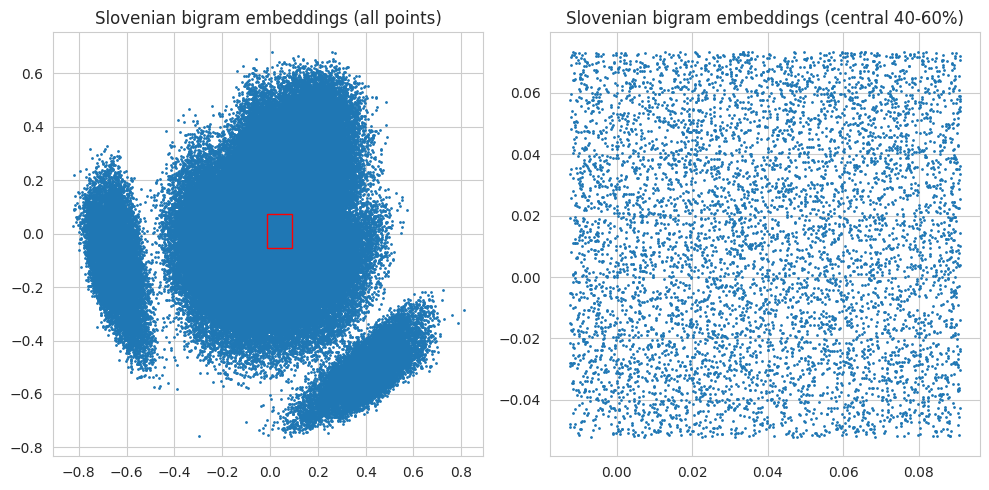

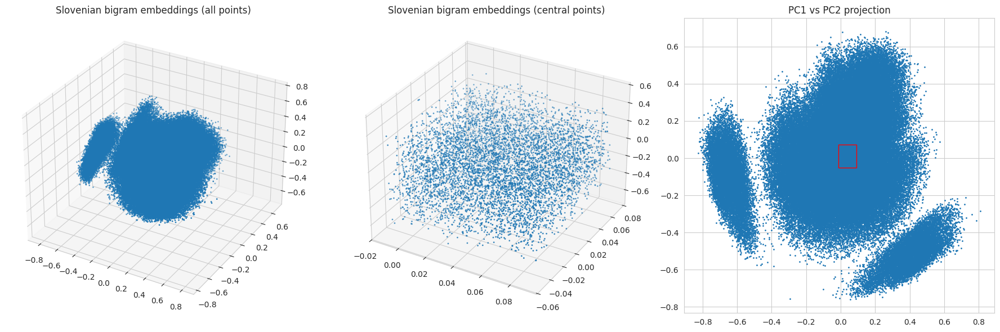

In [ ]:
slv_bigram_2d = pca_2d.fit_transform(slv_bigram_space)
slv_bigram_3d = pca_3d.fit_transform(slv_bigram_space)

# Visualize
visualize_2d(slv_bigram_2d, "Slovenian bigram embeddings")
visualize_3d(slv_bigram_3d, "Slovenian bigram embeddings")

# Test bigram d=200 embeddings

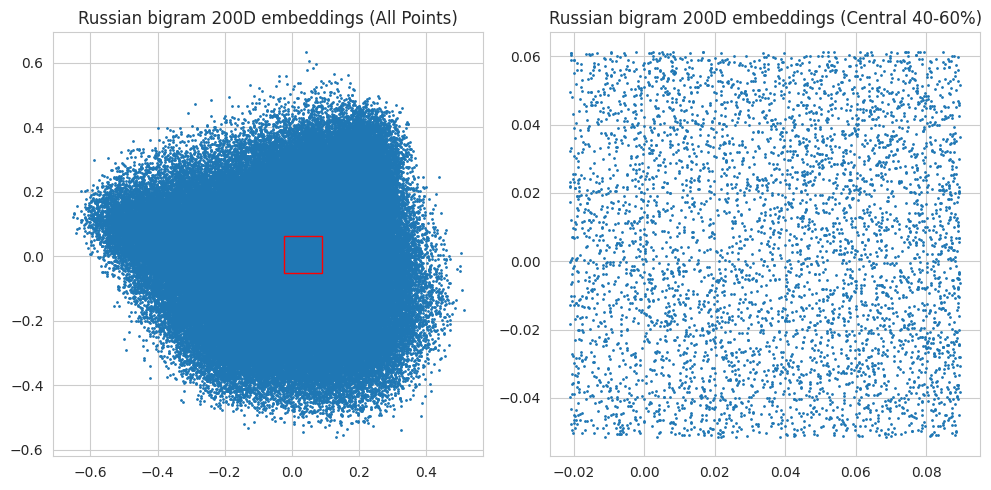

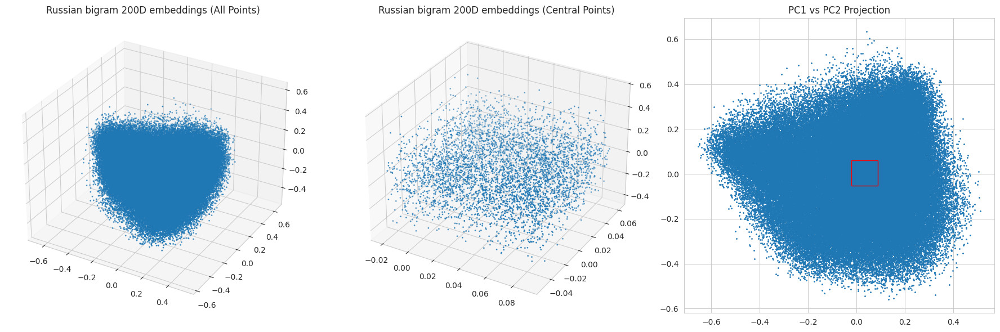

In [ ]:
ru_bigram200_space = np.load('ru_bigram200_norm_embeddings.npy')

ru_bigram200_2d = pca_2d.fit_transform(ru_bigram200_space)
ru_bigram200_3d = pca_3d.fit_transform(ru_bigram200_space)

# Visualize
visualize_2d(ru_bigram200_2d, "Russian bigram 200D embeddings")
visualize_3d(ru_bigram200_3d, "Russian bigram 200D embeddings")

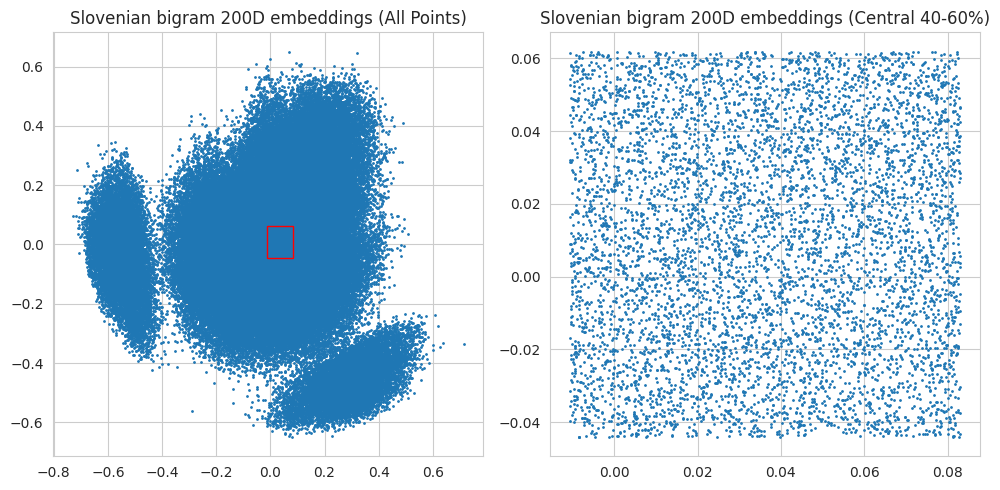

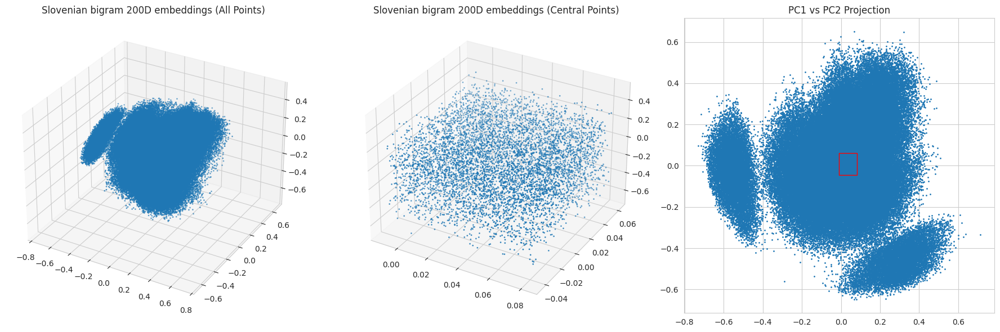

In [ ]:
slv_bigram200_space = np.load('slv_bigram200_norm_embeddings.npy')

slv_bigram200_2d = pca_2d.fit_transform(slv_bigram200_space)
slv_bigram200_3d = pca_3d.fit_transform(slv_bigram200_space)

# Visualize
visualize_2d(slv_bigram200_2d, "Slovenian bigram 200D embeddings")
visualize_3d(slv_bigram200_3d, "Slovenian bigram 200D embeddings")

# K-means for space partition

In [ ]:
from sklearn.cluster import KMeans
from collections import Counter
from mpl_toolkits.mplot3d import Axes3D

In [ ]:
# Load only vectors
ru_word_space = np.load('ru_cbow_normalized_embeddings.npy')
slv_word_space = np.load('slv_cbow_norm_embeddings.npy')

In [ ]:
def plot_clusters_3d(pca_3d, labels, title=""):
    """3D visualization of clustered embeddings"""
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(pca_3d[:, 0], pca_3d[:, 1], pca_3d[:, 2],
                        c=labels, s=1, cmap='viridis', alpha=0.6)
    plt.colorbar(scatter, label='Cluster')
    plt.title(f'3D Clusters: {title}')
    plt.show()

def plot_clusters_2d(pca_2d, labels, title="", percentile_range=(40, 60)):
    """2D visualization with central region highlighting"""
    xl, xr = np.percentile(pca_2d[:,0], percentile_range)
    yl, yr = np.percentile(pca_2d[:,1], percentile_range)
    idx = ((pca_2d[:,0] < xr) & (pca_2d[:,0] > xl) &
           (pca_2d[:,1] < yr) & (pca_2d[:,1] > yl))

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

    # All points
    sc1 = ax1.scatter(pca_2d[:, 0], pca_2d[:, 1], c=labels,
                     s=5, cmap='tab10', alpha=0.6)
    ax1.add_patch(Rectangle((xl, yl), xr-xl, yr-yl, color='r', fill=False, linewidth=2))
    ax1.set_title(f'{title}\nAll Points (Colored by Cluster)')
    plt.colorbar(sc1, ax=ax1, label='Cluster')

    # Central points
    sc2 = ax2.scatter(pca_2d[idx, 0], pca_2d[idx, 1], c=labels[idx],
                     s=5, cmap='tab10', alpha=0.6)
    ax2.set_title(f'Central Region ({percentile_range[0]}-{percentile_range[1]}th Percentile)')
    plt.colorbar(sc2, ax=ax2, label='Cluster')

    plt.tight_layout()
    plt.show()

## Words

In [ ]:
ru_word_km = KMeans(10, n_init=10, random_state=42)
ru_word_km.fit(ru_word_space)
Counter(ru_word_km.labels_)

Counter({np.int32(2): 9518,
         np.int32(9): 5560,
         np.int32(0): 8895,
         np.int32(8): 7076,
         np.int32(3): 8250,
         np.int32(6): 8372,
         np.int32(4): 6052,
         np.int32(7): 6424,
         np.int32(1): 7782,
         np.int32(5): 4182})

In [ ]:
slv_word_km = KMeans(10, n_init=10, random_state=42)
slv_word_km.fit(slv_word_space)
Counter(slv_word_km.labels_)

Counter({np.int32(0): 11975,
         np.int32(1): 10327,
         np.int32(6): 10880,
         np.int32(5): 14543,
         np.int32(4): 8701,
         np.int32(8): 9723,
         np.int32(3): 12572,
         np.int32(7): 13633,
         np.int32(2): 8764,
         np.int32(9): 21324})

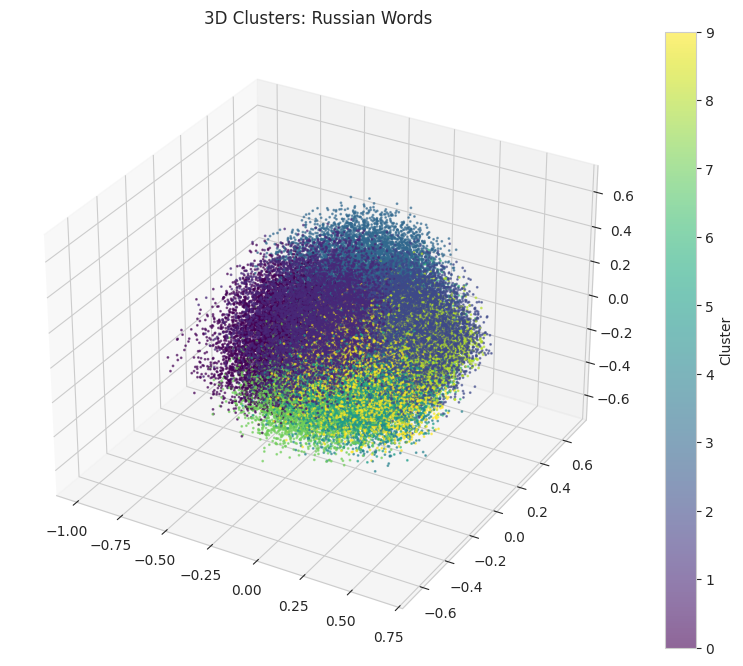

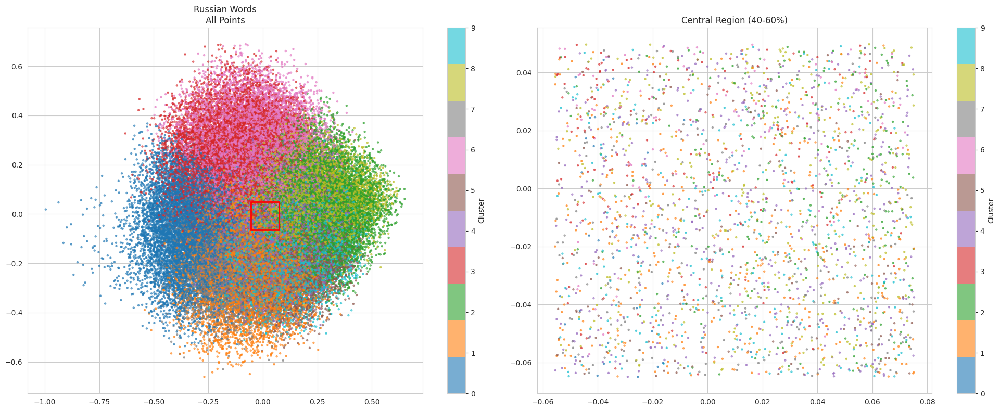

In [ ]:
plot_clusters_3d(ru_word_3d, ru_word_km.labels_, title='Russian words')
plot_clusters_2d(ru_word_2d, ru_word_km.labels_, title='Russian words')

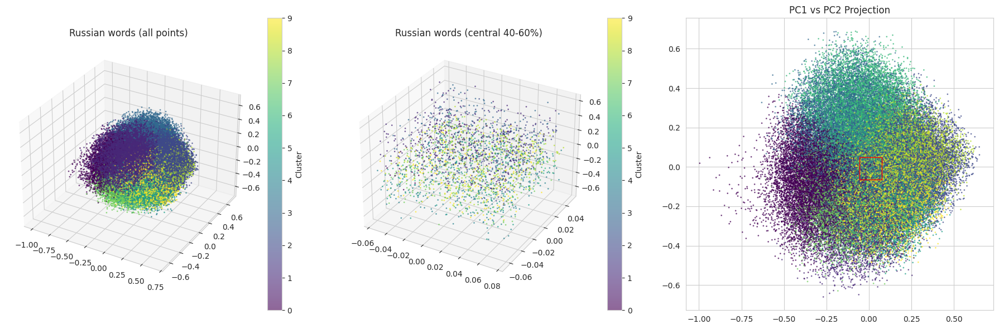

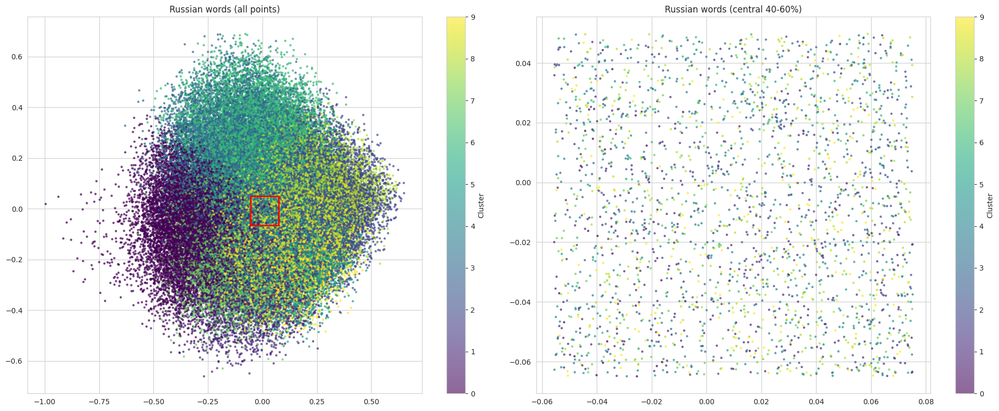

In [ ]:
plot_clusters_3d(ru_word_3d, ru_word_km.labels_, title='Russian words')
plot_clusters_2d(ru_word_2d, ru_word_km.labels_, title='Russian words')

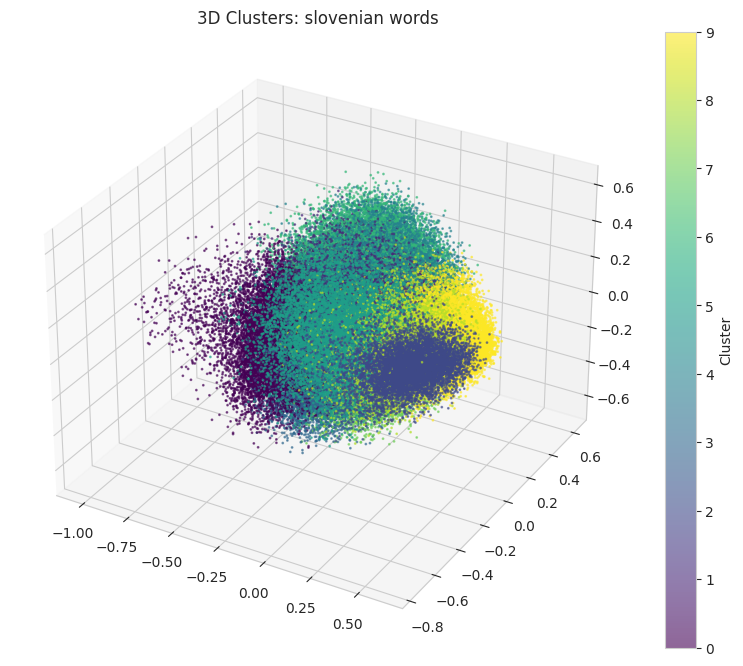

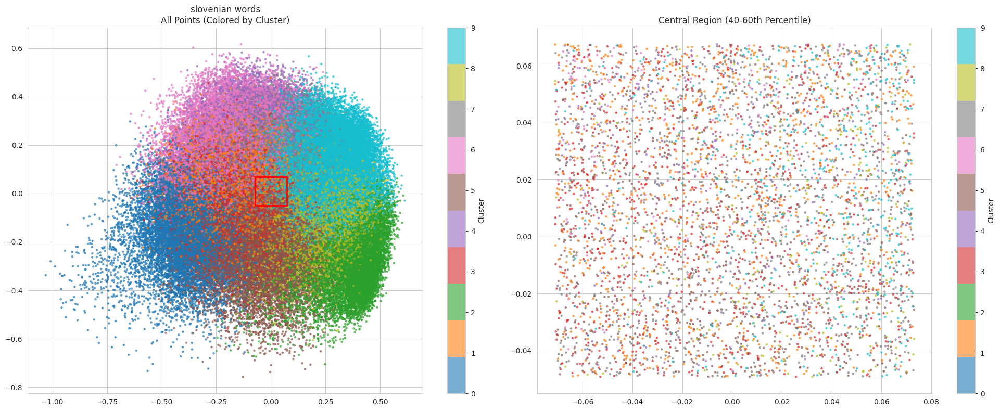

In [ ]:
plot_clusters_3d(slv_word_3d, slv_word_km.labels_, title='Slovenian words')
plot_clusters_2d(slv_word_2d, slv_word_km.labels_, title='Slovenian words')

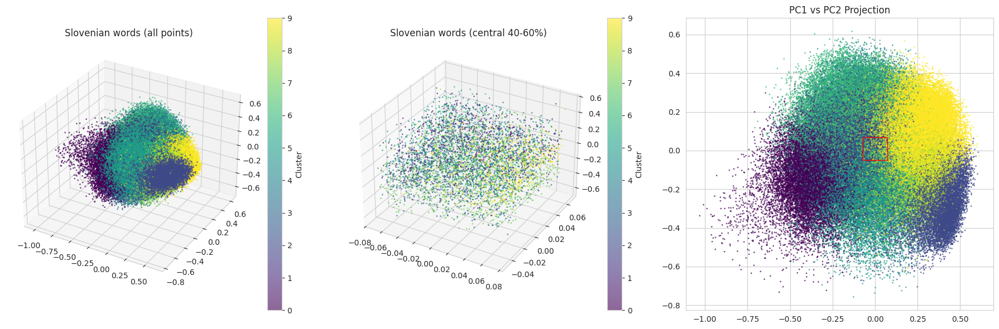

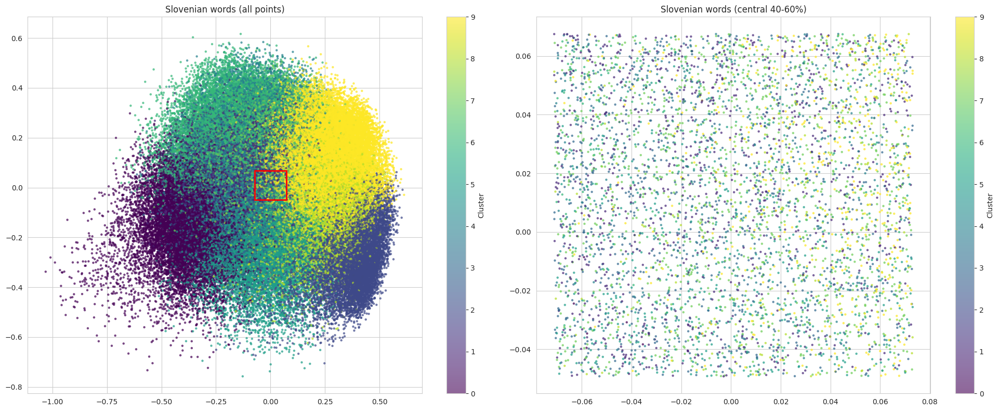

In [ ]:
plot_clusters_3d(slv_word_3d, slv_word_km.labels_, title='Slovenian words')
plot_clusters_2d(slv_word_2d, slv_word_km.labels_, title='Slovenian words')

In [ ]:
ru_word_partition_norm = np.array(ru_word_km.labels_.copy(), dtype='str')
np.save('ru_word_partition_norm.npy', ru_word_partition_norm)
Counter(ru_word_partition_norm)

Counter({np.str_('2'): 9518,
         np.str_('9'): 5560,
         np.str_('0'): 8895,
         np.str_('8'): 7076,
         np.str_('3'): 8250,
         np.str_('6'): 8372,
         np.str_('4'): 6052,
         np.str_('7'): 6424,
         np.str_('1'): 7782,
         np.str_('5'): 4182})

In [ ]:
for c in np.unique(ru_word_partition_norm):
    subset = ru_word_space[ru_word_partition_norm == c]
    print(c, subset.shape)
    np.save(f'ru_word_norm_{c}.npy', subset)

0 (8895, 100)
1 (7782, 100)
2 (9518, 100)
3 (8250, 100)
4 (6052, 100)
5 (4182, 100)
6 (8372, 100)
7 (6424, 100)
8 (7076, 100)
9 (5560, 100)


In [ ]:
slv_word_partition_norm = np.array(slv_word_km.labels_.copy(), dtype='str')
np.save('slv_word_partition_norm.npy', slv_word_partition_norm)
Counter(slv_word_partition_norm)

Counter({np.str_('0'): 11975,
         np.str_('1'): 10327,
         np.str_('6'): 10880,
         np.str_('5'): 14543,
         np.str_('4'): 8701,
         np.str_('8'): 9723,
         np.str_('3'): 12572,
         np.str_('7'): 13633,
         np.str_('2'): 8764,
         np.str_('9'): 21324})

In [ ]:
for c in np.unique(slv_word_partition_norm):
    subset = slv_word_space[slv_word_partition_norm == c]
    print(c, subset.shape)
    np.save(f'slv_word_norm_{c}.npy', subset)

0 (11975, 100)
1 (10327, 100)
2 (8764, 100)
3 (12572, 100)
4 (8701, 100)
5 (14543, 100)
6 (10880, 100)
7 (13633, 100)
8 (9723, 100)
9 (21324, 100)


## Update partition

In [ ]:
slv_word_partition_norm = np.load('slv_word_partition_norm.npy')
cluster_9 = np.load('slv_word_norm_9.npy')

# Split cluster 9 into 2 subclusters
slv_word_sub = KMeans(2, n_init=10, random_state=42)
slv_word_sub.fit(cluster_9)
sub_clusters = slv_word_sub.labels_
Counter(slv_word_sub.labels_)

Counter({np.int32(0): 11188, np.int32(1): 10136})

In [ ]:
# Update partition
new_partition = slv_word_partition_norm.copy()

cluster_9_indices = np.where(slv_word_partition_norm == '9')[0]
new_partition[cluster_9_indices] = np.where(sub_clusters == 0, '9a', '9b')
np.save('slv_word_partition_norm_split.npy', new_partition)

# Subclusters
for s in ['9a', '9b']:
    sub = cluster_9[new_partition[cluster_9_indices] == s]
    print(s, sub.shape)
    np.save(f'slv_word_norm_{s}.npy', sub)

print(Counter(new_partition))

9a (11188, 100)
9b (10136, 100)
Counter({np.str_('5'): 14543, np.str_('7'): 13633, np.str_('3'): 12572, np.str_('0'): 11975, np.str_('9a'): 11188, np.str_('6'): 10880, np.str_('1'): 10327, np.str_('9b'): 10136, np.str_('8'): 9723, np.str_('2'): 8764, np.str_('4'): 8701})


## Bigrams

In [ ]:
ru_bigram_km = KMeans(10, n_init=10, random_state=42)
ru_bigram_km.fit(ru_bigram_space)
Counter(ru_bigram_km.labels_)

Counter({np.int32(2): 12177,
         np.int32(7): 13257,
         np.int32(5): 20811,
         np.int32(3): 16769,
         np.int32(4): 16464,
         np.int32(9): 16201,
         np.int32(8): 17633,
         np.int32(6): 4793,
         np.int32(1): 4158,
         np.int32(0): 13596})

In [ ]:
slv_bigram_km = KMeans(10, n_init=10, random_state=42)
slv_bigram_km.fit(slv_bigram_space)
Counter(slv_bigram_km.labels_)

Counter({np.int32(3): 10217,
         np.int32(8): 12469,
         np.int32(9): 19276,
         np.int32(4): 13524,
         np.int32(7): 19912,
         np.int32(5): 14562,
         np.int32(0): 14303,
         np.int32(1): 17397,
         np.int32(6): 21656,
         np.int32(2): 4316})

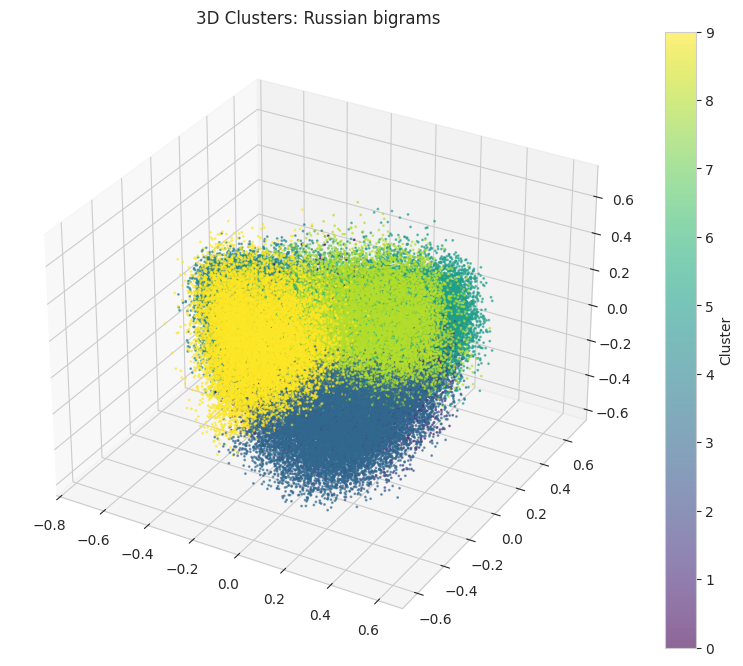

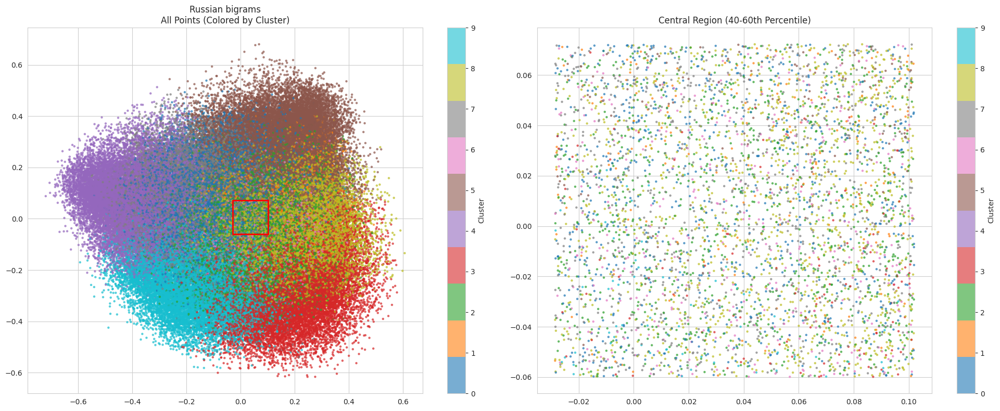

In [ ]:
plot_clusters_3d(ru_bigram_3d, ru_bigram_km.labels_, title='Russian bigrams')
plot_clusters_2d(ru_bigram_2d, ru_bigram_km.labels_, title='Russian bigrams')

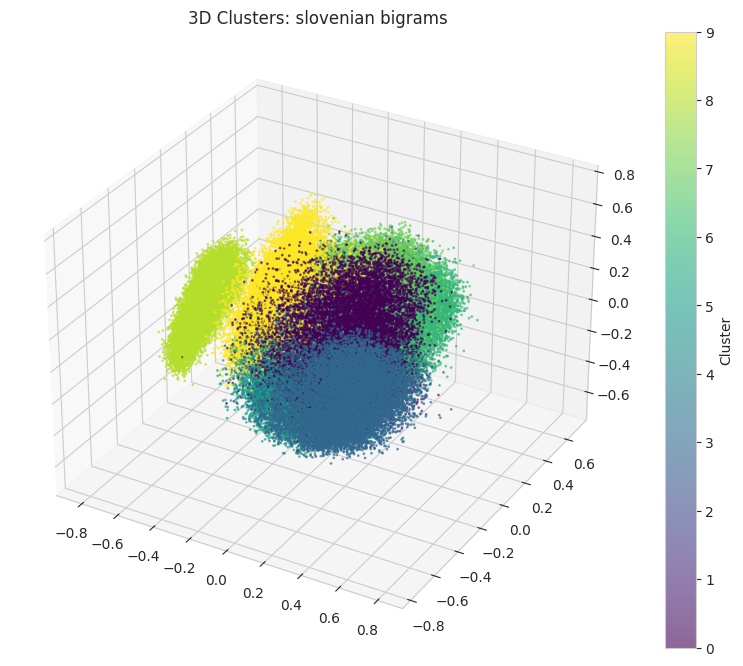

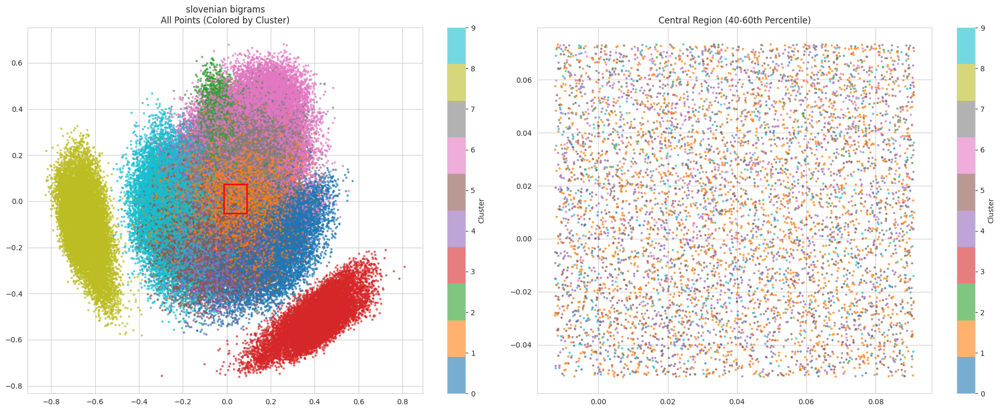

In [ ]:
plot_clusters_3d(slv_bigram_3d, slv_bigram_km.labels_, title='Slovenian bigrams')
plot_clusters_2d(slv_bigram_2d, slv_bigram_km.labels_, title='Slovenian bigrams')

In [ ]:
ru_bigram_partition_norm = np.array(ru_bigram_km.labels_.copy(), dtype='str')
np.save('ru_bigram_partition_norm.npy', ru_bigram_partition_norm)
Counter(ru_bigram_partition_norm)

Counter({np.str_('2'): 12177,
         np.str_('7'): 13257,
         np.str_('5'): 20811,
         np.str_('3'): 16769,
         np.str_('4'): 16464,
         np.str_('9'): 16201,
         np.str_('8'): 17633,
         np.str_('6'): 4793,
         np.str_('1'): 4158,
         np.str_('0'): 13596})

In [ ]:
for c in np.unique(ru_bigram_partition_norm):
    subset = ru_bigram_space[ru_bigram_partition_norm == c]
    print(c, subset.shape)
    np.save(f'ru_bigram_norm_{c}.npy', subset)

0 (13596, 100)
1 (4158, 100)
2 (12177, 100)
3 (16769, 100)
4 (16464, 100)
5 (20811, 100)
6 (4793, 100)
7 (13257, 100)
8 (17633, 100)
9 (16201, 100)


In [ ]:
slv_bigram_partition_norm = np.array(slv_bigram_km.labels_.copy(), dtype='str')
np.save('slv_bigram_partition_norm.npy', slv_bigram_partition_norm)
Counter(slv_bigram_partition_norm)

Counter({np.str_('3'): 10217,
         np.str_('8'): 12469,
         np.str_('9'): 19276,
         np.str_('4'): 13524,
         np.str_('7'): 19912,
         np.str_('5'): 14562,
         np.str_('0'): 14303,
         np.str_('1'): 17397,
         np.str_('6'): 21656,
         np.str_('2'): 4316})

In [ ]:
for c in np.unique(slv_bigram_partition_norm):
    subset = slv_bigram_space[slv_bigram_partition_norm == c]
    print(c, subset.shape)
    np.save(f'slv_bigram_norm_{c}.npy', subset)

0 (14303, 100)
1 (17397, 100)
2 (4316, 100)
3 (10217, 100)
4 (13524, 100)
5 (14562, 100)
6 (21656, 100)
7 (19912, 100)
8 (12469, 100)
9 (19276, 100)


## Update partition

In [ ]:
from matplotlib.colors import ListedColormap

def plot_clusters_3d(pca_3d, labels, title="", percentile_range=(40, 60)):
    """3D visualization with central region highlighting"""
    # Convert string labels to numerical values
    unique_labels = np.unique(labels)
    label_to_num = {label: i for i, label in enumerate(unique_labels)}
    numerical_labels = np.array([label_to_num[label] for label in labels])

    # Calculate central region
    xl, xr = np.percentile(pca_3d[:,0], percentile_range)
    yl, yr = np.percentile(pca_3d[:,1], percentile_range)
    idx = ((pca_3d[:,0] < xr) & (pca_3d[:,0] > xl) &
           (pca_3d[:,1] < yr) & (pca_3d[:,1] > yl))

    fig = plt.figure(figsize=(18, 6))

    # 3D Plot - All Points
    ax1 = fig.add_subplot(131, projection='3d')
    sc1 = ax1.scatter(pca_3d[:, 0], pca_3d[:, 1], pca_3d[:, 2],
                     c=numerical_labels, s=1, cmap='viridis', alpha=0.6)
    ax1.set_title(f'{title} (all points)')

    # 3D Plot - Central Points
    ax2 = fig.add_subplot(132, projection='3d')
    sc2 = ax2.scatter(pca_3d[idx, 0], pca_3d[idx, 1], pca_3d[idx, 2],
                     c=numerical_labels[idx], s=1, cmap='viridis', alpha=0.6)
    ax2.set_title(f'{title} (central {percentile_range[0]}-{percentile_range[1]}%)')

    # 2D Projection
    ax3 = fig.add_subplot(133)
    sc3 = ax3.scatter(pca_3d[:, 0], pca_3d[:, 1],
                     c=numerical_labels, s=1, cmap='viridis', alpha=0.6)
    rect = Rectangle((xl, yl), xr-xl, yr-yl, color='r', fill=False)
    ax3.add_patch(rect)
    ax3.set_title('PC1 vs PC2 Projection')

    # Add colorbars (same for both subplots)
    for sc, ax in zip([sc1, sc2], [ax1, ax2]):
        cbar = plt.colorbar(sc, ax=ax, ticks=range(len(unique_labels)))
        cbar.set_ticklabels(unique_labels)
        cbar.set_label('Cluster')

    plt.tight_layout()
    plt.show()


def plot_clusters_2d(pca_2d, labels, title="", percentile_range=(40, 60)):
    """2D visualization with the same viridis gradient as 3D"""
    unique_labels = np.unique(labels)
    label_to_num = {label: i for i, label in enumerate(unique_labels)}
    numerical_labels = np.array([label_to_num[label] for label in labels])

    # Normalize numerical_labels to [0,1] for consistent gradient
    norm = plt.Normalize(vmin=0, vmax=len(unique_labels)-1)

    xl, xr = np.percentile(pca_2d[:, 0], percentile_range)
    yl, yr = np.percentile(pca_2d[:, 1], percentile_range)
    idx = ((pca_2d[:, 0] < xr) & (pca_2d[:, 0] > xl) &
           (pca_2d[:, 1] < yr) & (pca_2d[:, 1] > yl))

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

    # All points (left subplot) - using 'viridis'
    sc1 = ax1.scatter(
        pca_2d[:, 0], pca_2d[:, 1],
        c=numerical_labels, s=5, cmap='viridis', alpha=0.6, norm=norm
    )
    ax1.add_patch(Rectangle((xl, yl), xr-xl, yr-yl, color='r', fill=False, linewidth=2))
    ax1.set_title(f'{title} (all points)')

    # Central points (right subplot) - same colormap
    sc2 = ax2.scatter(
        pca_2d[idx, 0], pca_2d[idx, 1],
        c=numerical_labels[idx], s=5, cmap='viridis', alpha=0.6, norm=norm
    )
    ax2.set_title(f'{title} (central {percentile_range[0]}-{percentile_range[1]}%)')

    # Add colorbars (same for both subplots)
    for sc, ax in zip([sc1, sc2], [ax1, ax2]):
        cbar = plt.colorbar(sc, ax=ax, ticks=range(len(unique_labels)))
        cbar.set_ticklabels(unique_labels)
        cbar.set_label('Cluster')

    plt.tight_layout()
    plt.show()

In [ ]:
# Function to split a cluster
def split_cluster(original_partition, cluster_num, cluster_data):
    # Split cluster into 2 subclusters
    kmeans = KMeans(2, n_init=10, random_state=42)
    kmeans.fit(cluster_data)
    sub_clusters = kmeans.labels_

    # Update partition
    new_partition = original_partition.copy()
    cluster_indices = np.where(original_partition == str(cluster_num))[0]
    new_partition[cluster_indices] = np.where(sub_clusters == 0, f'{cluster_num}a', f'{cluster_num}b')

    # Save subclusters
    for s in [f'{cluster_num}a', f'{cluster_num}b']:
        sub = cluster_data[new_partition[cluster_indices] == s]
        print(s, sub.shape)
        np.save(f'ru_bigram_norm_{s}.npy', sub)

    return new_partition

In [ ]:
# Original partition
ru_bigram_partition_norm = np.load('ru_bigram_partition_norm.npy')

In [ ]:
# Split cluster 5
cluster_5 = np.load('ru_bigram_norm_5.npy')
new_partition = split_cluster(ru_bigram_partition_norm, 5, cluster_5)

# Split cluster 8
cluster_8 = np.load('ru_bigram_norm_8.npy')
new_partition = split_cluster(new_partition, 8, cluster_8)

# Split cluster 3
cluster_3 = np.load('ru_bigram_norm_3.npy')
new_partition = split_cluster(new_partition, 3, cluster_3)

# Split cluster 4
cluster_4 = np.load('ru_bigram_norm_4.npy')
new_partition = split_cluster(new_partition, 4, cluster_4)

# Save final partition
np.save('ru_bigram_partition_norm_split.npy', new_partition)
print(Counter(new_partition))

5a (12252, 100)
5b (8559, 100)
8a (3520, 100)
8b (14113, 100)
3a (13220, 100)
3b (3549, 100)
4a (8422, 100)
4b (8042, 100)
Counter({np.str_('9'): 16201, np.str_('8b'): 14113, np.str_('0'): 13596, np.str_('7'): 13257, np.str_('3a'): 13220, np.str_('5a'): 12252, np.str_('2'): 12177, np.str_('5b'): 8559, np.str_('4a'): 8422, np.str_('4b'): 8042, np.str_('6'): 4793, np.str_('1'): 4158, np.str_('3b'): 3549, np.str_('8a'): 3520})


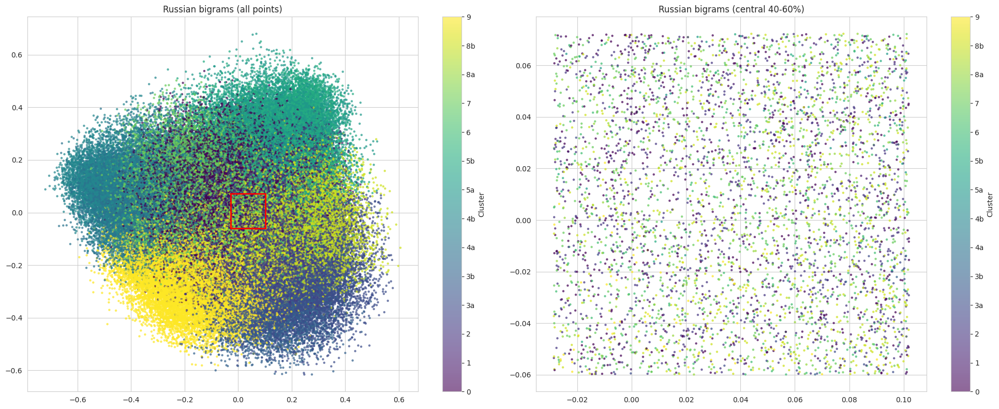

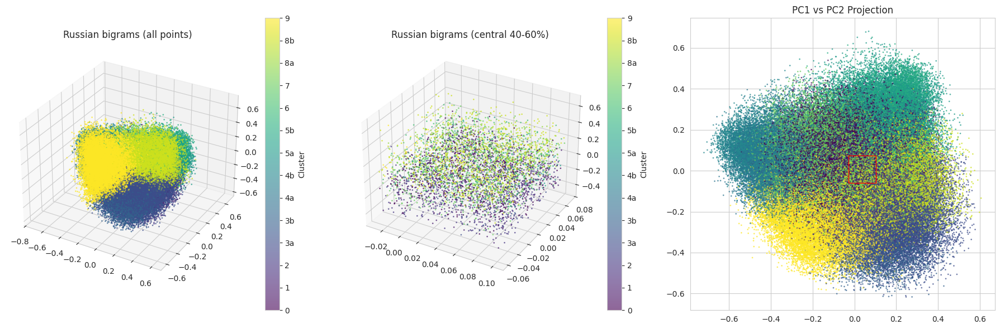

In [ ]:
plot_clusters_2d(ru_bigram_2d, new_partition, title='Russian bigrams')
plot_clusters_3d(ru_bigram_3d, new_partition, title='Russian bigrams')

In [ ]:
# Function to split a cluster
def split_cluster(original_partition, cluster_num, cluster_data):
    # Split cluster into 2 subclusters
    kmeans = KMeans(2, n_init=10, random_state=42)
    kmeans.fit(cluster_data)
    sub_clusters = kmeans.labels_

    # Update partition
    new_partition = original_partition.copy()
    cluster_indices = np.where(original_partition == str(cluster_num))[0]
    new_partition[cluster_indices] = np.where(sub_clusters == 0, f'{cluster_num}a', f'{cluster_num}b')

    # Save subclusters
    for s in [f'{cluster_num}a', f'{cluster_num}b']:
        sub = cluster_data[new_partition[cluster_indices] == s]
        print(s, sub.shape)
        np.save(f'slv_bigram_norm_{s}.npy', sub)

    return new_partition

In [ ]:
# Original partition
slv_bigram_partition_norm = np.load('slv_bigram_partition_norm.npy')

In [ ]:
slv_bigram_partition_norm

np.True_

In [ ]:
# Split cluster 6
cluster_6 = np.load('slv_bigram_norm_6.npy')
new_partition = split_cluster(slv_bigram_partition_norm, 6, cluster_6)

# Split cluster 9
cluster_9 = np.load('slv_bigram_norm_9.npy')
new_partition = split_cluster(new_partition, 9, cluster_9)

# Split cluster 5
cluster_5 = np.load('slv_bigram_norm_5.npy')
new_partition = split_cluster(new_partition, 5, cluster_5)

# Save final partition
np.save('slv_bigram_partition_norm_split.npy', new_partition)
print(Counter(new_partition))

6a (10361, 100)
6b (11295, 100)
9a (4454, 100)
9b (14822, 100)
5a (4572, 100)
5b (9990, 100)
Counter({np.str_('7'): 19912, np.str_('1'): 17397, np.str_('9b'): 14822, np.str_('0'): 14303, np.str_('4'): 13524, np.str_('8'): 12469, np.str_('6b'): 11295, np.str_('6a'): 10361, np.str_('3'): 10217, np.str_('5b'): 9990, np.str_('5a'): 4572, np.str_('9a'): 4454, np.str_('2'): 4316})


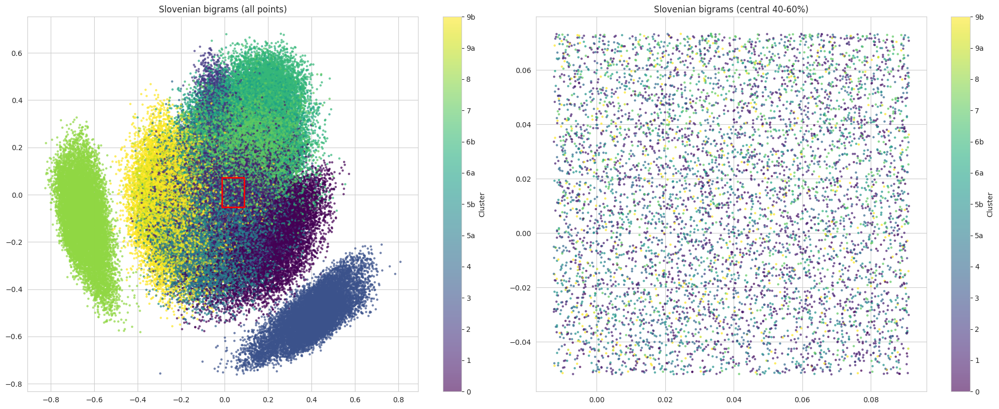

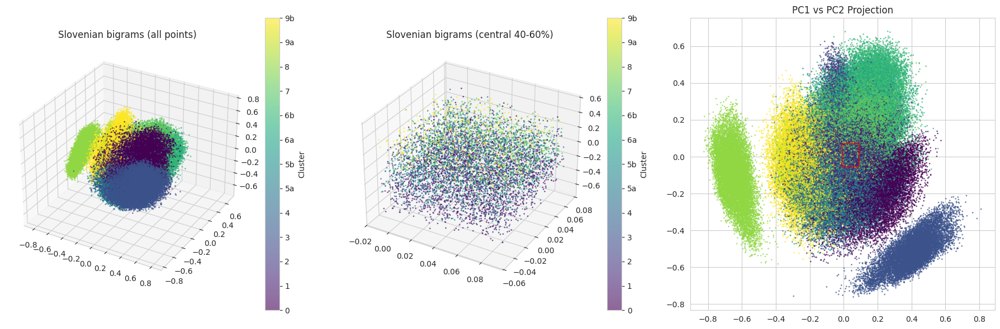

In [ ]:
plot_clusters_2d(slv_bigram_2d, new_partition, title='Slovenian bigrams')
plot_clusters_3d(slv_bigram_3d, new_partition, title='Slovenian bigrams')

## Individual update

In [ ]:
ru_bigram_partition_norm = np.load('ru_bigram_partition_norm.npy')
cluster_5 = np.load('ru_bigram_norm_5.npy')

# Split cluster 5 into 2 subclusters
ru_bigram_sub = KMeans(2, n_init=10, random_state=42)
ru_bigram_sub.fit(cluster_5)
sub_clusters = ru_bigram_sub.labels_
Counter(ru_bigram_sub.labels_)

Counter({np.int32(1): 8559, np.int32(0): 12252})

In [ ]:
# Update partition
new_partition = ru_bigram_partition_norm.copy()

cluster_5_indices = np.where(ru_bigram_partition_norm == '5')[0]
new_partition[cluster_5_indices] = np.where(sub_clusters == 0, '5a', '5b')
np.save('ru_bigram_partition_norm_split.npy', new_partition)

# Subclusters
for s in ['5a', '5b']:
    sub = cluster_5[new_partition[cluster_5_indices] == s]
    print(s, sub.shape)
    np.save(f'ru_bigram_norm_{s}.npy', sub)

print(Counter(new_partition))

5a (12252, 100)
5b (8559, 100)
Counter({np.str_('8'): 17633, np.str_('3'): 16769, np.str_('4'): 16464, np.str_('9'): 16201, np.str_('0'): 13596, np.str_('7'): 13257, np.str_('5a'): 12252, np.str_('2'): 12177, np.str_('5b'): 8559, np.str_('6'): 4793, np.str_('1'): 4158})


In [ ]:
slv_bigram_partition_norm = np.load('slv_bigram_partition_norm.npy')
cluster_6 = np.load('slv_bigram_norm_6.npy')

# Split cluster 6 into 2 subclusters
slv_bigram_sub = KMeans(2, n_init=10, random_state=42)
slv_bigram_sub.fit(cluster_6)
sub_clusters = slv_bigram_sub.labels_
Counter(slv_bigram_sub.labels_)

Counter({np.int32(0): 10361, np.int32(1): 11295})

In [ ]:
# Update partition
new_partition = slv_bigram_partition_norm.copy()

cluster_6_indices = np.where(slv_bigram_partition_norm == '6')[0]
new_partition[cluster_6_indices] = np.where(sub_clusters == 0, '6a', '6b')
np.save('slv_bigram_partition_norm_split.npy', new_partition)

# Subclusters
for s in ['6a', '6b']:
    sub = cluster_6[new_partition[cluster_6_indices] == s]
    print(s, sub.shape)
    np.save(f'slv_bigram_norm_{s}.npy', sub)

print(Counter(new_partition))

6a (10361, 100)
6b (11295, 100)
Counter({np.str_('7'): 19912, np.str_('9'): 19276, np.str_('1'): 17397, np.str_('5'): 14562, np.str_('0'): 14303, np.str_('4'): 13524, np.str_('8'): 12469, np.str_('6b'): 11295, np.str_('6a'): 10361, np.str_('3'): 10217, np.str_('2'): 4316})
